# PCA

In [1]:
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.image import imread
%matplotlib inline

import numpy as np
from sklearn.decomposition import PCA, IncrementalPCA

from typing import List
%load_ext watermark

In [2]:
%watermark --iso8601 -u -v -m -iv 

Last updated: 2024-02-06T21:27:31.754370-05:00

Python implementation: CPython
Python version       : 3.12.1
IPython version      : 8.21.0

Compiler    : Clang 16.0.6 
OS          : Darwin
Release     : 23.2.0
Machine     : arm64
Processor   : arm
CPU cores   : 8
Architecture: 64bit

matplotlib: 3.8.2
numpy     : 1.26.3
PIL       : 10.2.0



<br>

## Data
Since the data is a single image, we just download it (any image) from the internet.
<br>The image used for this notebook is from https://esahubble.org/images/heic1501b/

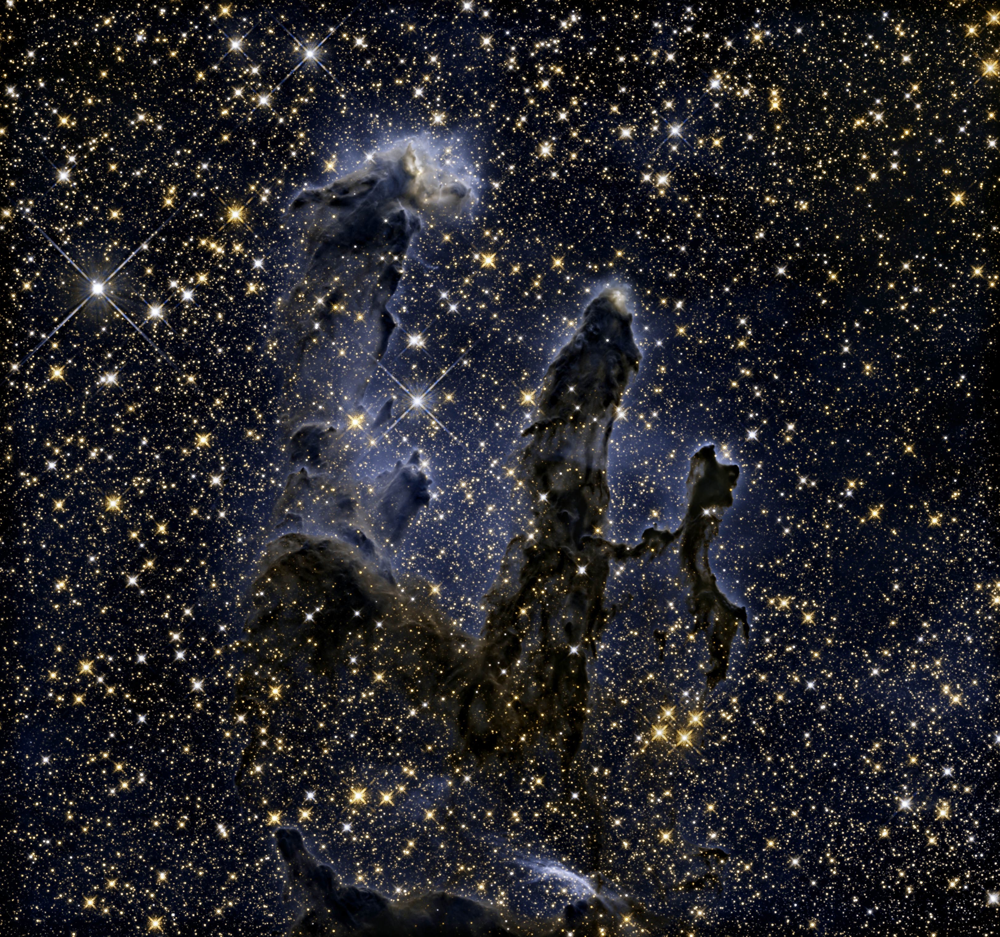

In [3]:
img_path = './data/heic1501b.tif'
img = Image.open(img_path)
img

In [4]:
print(f"Image height: {img.height}\n"
      f"Image width : {img.width}")

Image height: 3045
Image width : 3249


<br>

## PCA on the Grayscaled Version
Source: https://www.dataknowsall.com/imagepca.html
<br>Since PCA needs a single channel, we perform PCA on the grayscale version of the image.

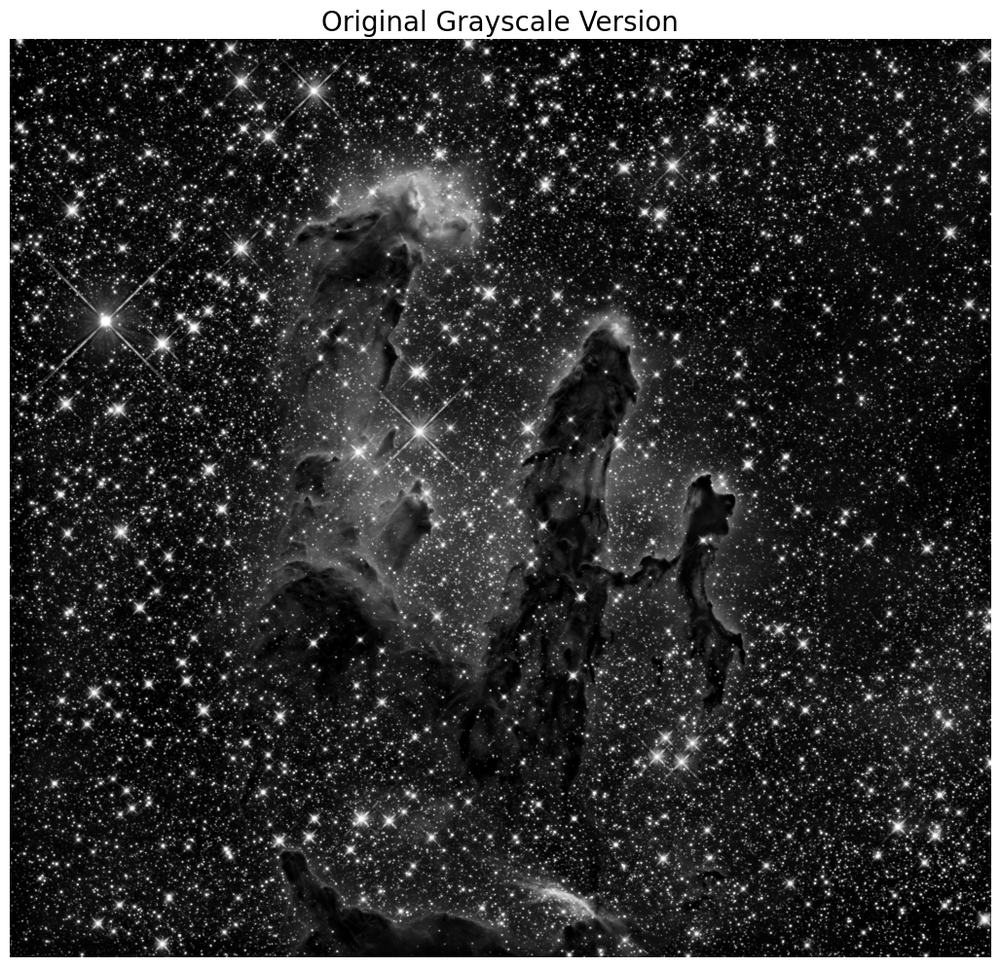

In [5]:
img_raw = imread(img_path)

# Show the new shape of the image
image_sum = img_raw.sum(axis=2)

# Show the max value at any point.  1.0 = Black, 0.0 = White
image_bw = image_sum/image_sum.max()

fig = plt.figure(figsize=(13, 13))
plt.axis('off')
plt.title("Original Grayscale Version", fontsize=20)
plt.imshow(image_bw, cmap = plt.cm.gray);

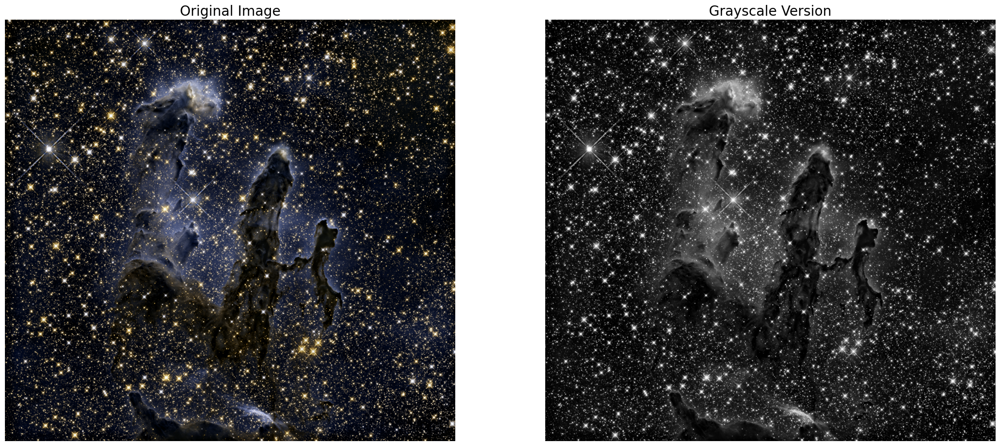

In [26]:
plt.figure(figsize=[26,13])

# Plot the original image
plt.subplot(1, 2, 1)
plt.imshow(img_raw);
plt.axis('off') 
plt.title(f"Original Image", fontsize=20)

# Plot the grayscale image
plt.subplot(1, 2, 2)
plt.imshow(image_bw, cmap = plt.cm.gray);
plt.axis('off') 
plt.title(f"Grayscale Version", fontsize=20)

# plt.subplots_adjust(wspace=0.2, hspace=0.0)
plt.savefig("./images/original_and_grayscal.png", bbox_inches='tight')
plt.show();

<br>

## PCA

Fit our grayscale image with PCA from Scikit-Learn. 

In [7]:
# Define the PCA object and fit the black and white image
pca = PCA()
pca.fit(image_bw)

PCA()

### Calculating Explained Variance
Using `pca.explained_variance_ratio_` which returns the percentage of variance explained by each of the principal components. 
<br>Using `np.cumsum`, add up each of the variance per component until it reaches 100% for the final component.

In [8]:
# Getting the cumulative variance
var_cumu = np.cumsum(pca.explained_variance_ratio_)*100

# How many PCs explain 95% of the variance?
k = np.argmax(var_cumu>95)

print(f"Total number of components in the black and white image : {len(pca.components_)}")
print(f"Number of components explaining 95% variance             : {k}")

Total number of componenets in the black and white image : 3045
Number of components explaining 95% variance             : 403


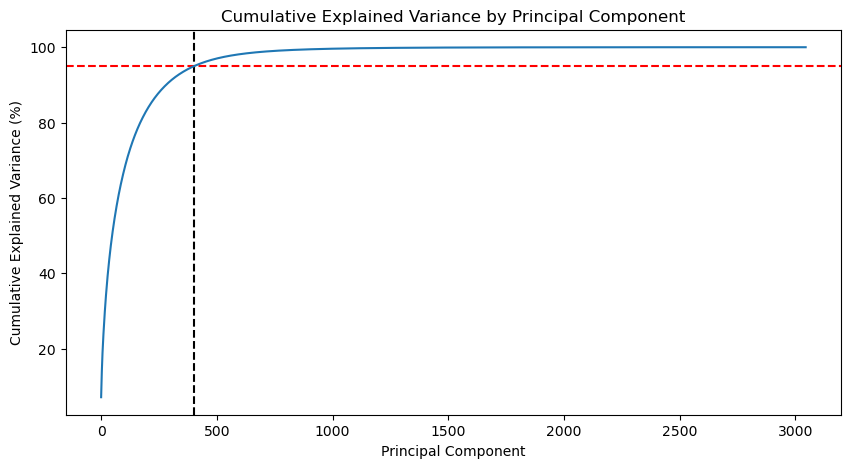

In [27]:
plt.figure(figsize=[10,5])
plt.title('Cumulative Explained Variance by Principal Component')
plt.ylabel('Cumulative Explained Variance (%)')
plt.xlabel('Principal Component')

plt.axvline(x=k, color="k", linestyle="--")
plt.axhline(y=95, color="r", linestyle="--")

ax = plt.plot(var_cumu)
plt.savefig("./images/cumulative_var_pcs.png", bbox_inches='tight')

### Reducing Dimensionality with PCA
Use `fit_transform` method from `IncrementalPCA` to first find the `k` PCs and transform them.
This represents the data in those `k` new components/columns.

In [10]:
ipca = IncrementalPCA(n_components=k)
image_bw_recon = ipca.inverse_transform(ipca.fit_transform(image_bw))

Reconstruct the original matrix from these `k` components using the `inverse_transform` method.

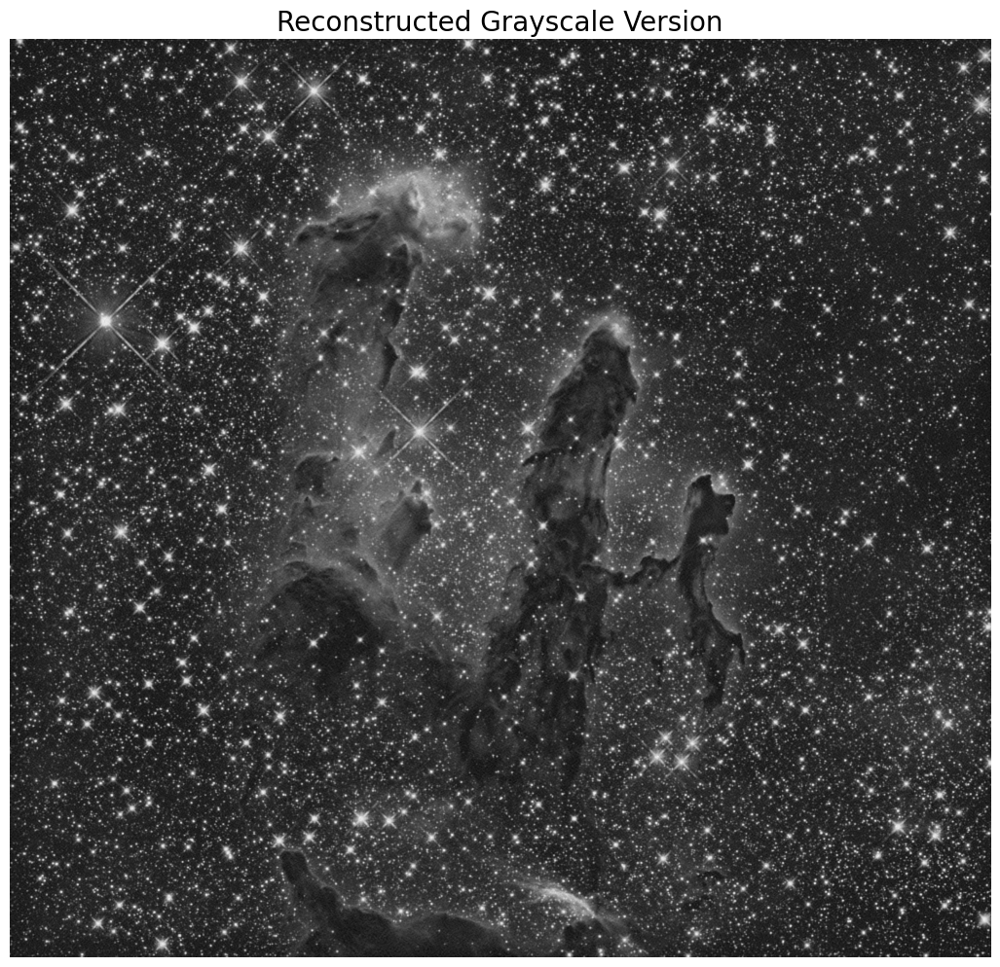

In [29]:
# Plotting the reconstructed image
fig = plt.figure(figsize=(13, 13))
plt.axis('off')
plt.title("Reconstructed Grayscale Version", fontsize=20)
plt.imshow(image_bw_recon, cmap = plt.cm.gray);
plt.savefig("./images/recons_gray.png", bbox_inches='tight')

### Error Estimation

Find the error estimate for recovery. The error is given by:
$$\text{re} = \frac{1}{n}\sum_{i=1}^n \Vert x_i-r(x_i)\Vert^2$$
where $n$ is the number of samples, $x_i$ is the original data point, and $r(x_i)$ is the reconstructed data point.
<br>Note that since their was no need to shift the original image to a zero mean, the error function needs to account for the absence of that shift. Thus resulting in the $\frac{1}{n}$ term.

In [12]:
def mean_squared_error(image1, image2):
    return np.mean((image1 - image2) ** 2)

In [13]:
mse = mean_squared_error(image_bw, image_bw_recon)
print(f"Mean Squared Error of the original image: {mse*100:.2%}")

Mean Squared Error of the original image: 14.04%


### Emperical `k` Values
Iterative over 3 different k-values, representing one, two, and three standard deviations from the mean, for the image.

In [14]:
def plot_and_get_error(image_bw, k):
    ipca = IncrementalPCA(n_components=k)
    image_recon = ipca.inverse_transform(ipca.fit_transform(image_bw))    
    plt.imshow(image_recon, cmap = plt.cm.gray)

    return mean_squared_error(image_bw, image_recon)

In [15]:
# get PCs that explain the 68–95–99.7 rule
ks = [np.argmax(var_cumu>68), np.argmax(var_cumu>95), np.argmax(var_cumu>99.7)]
ks

[102, 403, 1084]

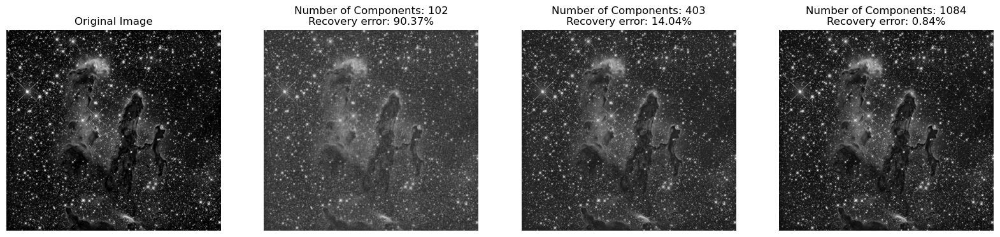

In [30]:
plt.figure(figsize=[20,14])

# Plot the original image
plt.subplot(1, 4, 1)
plt.imshow(image_bw, cmap = plt.cm.gray);
plt.axis('off') 
plt.title(f"Original Image")

for i in range(len(ks)):
    plt.subplot(1, 4, i+2)
    mse = plot_and_get_error(image_bw, ks[i])
    plt.axis('off') 
    plt.title(f"Number of Components: {ks[i]}\n"
              f"Recovery error: {mse*100:.2%}")

# plt.subplots_adjust(wspace=0.2, hspace=0.0)
plt.savefig("./images/recons_comp.png", bbox_inches='tight')
plt.show();